In [1]:
# import necessary packages
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers

from kaggle_datasets import KaggleDatasets
import matplotlib.pyplot as plt
import numpy as np
from tqdm import tqdm

import cv2
from PIL import Image
import shutil

E0000 00:00:1741567126.475951      10 common_lib.cc:612] Could not set metric server port: INVALID_ARGUMENT: Could not find SliceBuilder port 8471 in any of the 0 ports provided in `tpu_process_addresses`="local"
=== Source Location Trace: === 
learning/45eac/tfrc/runtime/common_lib.cc:230


In [2]:
# set up to use TPU environment in Kaggle
try:
    tpu = tf.distribute.cluster_resolver.TPUClusterResolver.connect(tpu='local')
    strategy = tf.distribute.TPUStrategy(tpu)
    print('use TPU')
except:
    print('use default strategy')
    strategy = tf.distribute.get_strategy()
print(f'Number of replicas: {strategy.num_replicas_in_sync}')

AUTOTUNE = tf.data.experimental.AUTOTUNE

INFO:tensorflow:Deallocate tpu buffers before initializing tpu system.
INFO:tensorflow:Initializing the TPU system: local


I0000 00:00:1741567149.904330      10 service.cc:148] XLA service 0x5b5f4d0395d0 initialized for platform TPU (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1741567149.904377      10 service.cc:156]   StreamExecutor device (0): TPU, 2a886c8
I0000 00:00:1741567149.904382      10 service.cc:156]   StreamExecutor device (1): TPU, 2a886c8
I0000 00:00:1741567149.904387      10 service.cc:156]   StreamExecutor device (2): TPU, 2a886c8
I0000 00:00:1741567149.904390      10 service.cc:156]   StreamExecutor device (3): TPU, 2a886c8
I0000 00:00:1741567149.904392      10 service.cc:156]   StreamExecutor device (4): TPU, 2a886c8
I0000 00:00:1741567149.904395      10 service.cc:156]   StreamExecutor device (5): TPU, 2a886c8
I0000 00:00:1741567149.904398      10 service.cc:156]   StreamExecutor device (6): TPU, 2a886c8
I0000 00:00:1741567149.904401      10 service.cc:156]   StreamExecutor device (7): TPU, 2a886c8


INFO:tensorflow:Finished initializing TPU system.
INFO:tensorflow:Found TPU system:
INFO:tensorflow:*** Num TPU Cores: 8
INFO:tensorflow:*** Num TPU Workers: 1
INFO:tensorflow:*** Num TPU Cores Per Worker: 8
INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:localhost/replica:0/task:0/device:CPU:0, CPU, 0, 0)
INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:localhost/replica:0/task:0/device:TPU:0, TPU, 0, 0)
INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:localhost/replica:0/task:0/device:TPU:1, TPU, 0, 0)
INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:localhost/replica:0/task:0/device:TPU:2, TPU, 0, 0)
INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:localhost/replica:0/task:0/device:TPU:3, TPU, 0, 0)
INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:localhost/replica:0/task:0/device:TPU:4, TPU, 0, 0)
INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:localhost/replica:0/task:0/device:TPU:5, TPU, 0, 0)
I

# Description of the problem/data

In this task, the objective is to learn Claude Monet's unique style, such as his color choices and brush strokes, from a series of images and transform completely different photos into Monet's style, allowing the model to generate new images in his style. This is achieved using a GAN (Generative Adversarial Network). In GANs, two models, called the Generator and the Discriminator, are trained to compete against each other, allowing both models to improve progressively. By utilizing this method, the task is to generate 7,000 to 10,000 images that can be classified as Monet's style.

The evaluation metric for this task is MiFID (Memorization-informed Fréchet Inception Distance). This metric penalizes the model if it directly reproduces existing images, encouraging the generation of novel and original content.

The available image formats for training are provided as jpg and tfrec. Using these images, the Generator and Discriminator models will be trained. The final generated images must be submitted in jpg format, compressed as a zip file named images.zip, and uploaded on Kaggle for evaluation.

The dataset is as follows:

monet_jpg: 300 Monet paintings in JPEG format, sized 256 x 256
monet_tfrec: 300 Monet paintings in TFRecord format, sized 256 x 256
photo_jpg: 7,028 photos in JPEG format, sized 256 x 256
photo_tfrec: 7,028 photos in TFRecord format, sized 256 x 256
It is also possible to prepare your own data and increase the total number of images up to 10,000.

In [3]:
# load data
# IMG_PATH = KaggleDatasets().get_gcs_path()
IMG_PATH = '/kaggle/input/gan-getting-started'
print(f'IMG_PATH: {IMG_PATH}')
MONET_FILENAMES = tf.io.gfile.glob(f'{IMG_PATH}/monet_tfrec/*.tfrec')
MONET_JPEG_FILENAMES = tf.io.gfile.glob(f'{IMG_PATH}/monet_jpg/*.jpg')
PHOTO_FILENAMES = tf.io.gfile.glob(f'{IMG_PATH}/photo_tfrec/*.tfrec')
PHOTO_JPEG_FILENAMES = tf.io.gfile.glob(f'{IMG_PATH}/photo_jpg/*.jpg')

IMG_PATH: /kaggle/input/gan-getting-started


In [4]:
# check the given files
def check_given_files(m_tfrec_files, m_jpeg_files, p_tfrec_files, p_jpeg_files):
    print(f'Monet TFRecord Files: {len(m_tfrec_files)}')
    print(f'Monet JPEG Files: {len(m_jpeg_files)}')
    print(f'Photo TFRecord Files: {len(p_tfrec_files)}')
    print(f'Photo JPEG Files: {len(p_jpeg_files)}')
check_given_files(*[MONET_FILENAMES, MONET_JPEG_FILENAMES, PHOTO_FILENAMES, PHOTO_JPEG_FILENAMES])

Monet TFRecord Files: 5
Monet JPEG Files: 300
Photo TFRecord Files: 20
Photo JPEG Files: 7038


# Exploratory Data Analysis (EDA)

It can be confirmed that the JPEG images are saved in 256x256 resolution with 3 RGB channels.

In [5]:
def show_image_information(file_path):
    img = Image.open(file_path)
    width, height = img.size
    print(f'these images have width: {width}, height: {height}')
    print(f'these images are {img.mode}')
    print(f'these image format is {img.format}')
show_image_information(MONET_JPEG_FILENAMES[0])

these images have width: 256, height: 256
these images are RGB
these image format is JPEG


What exactly is Monet's artistic expression like?
First, we will display 16 Monet paintings and 16 photographs side by side to visually observe Monet's style.

It is clear that Monet's style is significantly different from regular photographs, as the brushstrokes are distinctly visible, leaving a strong texture on the canvas.

In [6]:
# define functions which is related to load dataset and read, decode TFRecord 
def decode_image(image, image_size=(256, 256)):
    max_intensity = 255
    image = tf.image.decode_jpeg(image, channels=3) # 0 to 255
    image = (tf.cast(image, tf.float32) / (max_intensity / 2)) # 0 to 2
    image = image - 1 # -1 to 1
    image = tf.reshape(image, [*image_size, 3])
    return image

def read_tfrecord(example):
    tfrecord_format = {
        "image_name": tf.io.FixedLenFeature([], tf.string),
        "image": tf.io.FixedLenFeature([], tf.string),
        "target": tf.io.FixedLenFeature([], tf.string)
    }
    example = tf.io.parse_single_example(example, tfrecord_format)
    image = decode_image(example['image'])
    return image

def load_dataset(filenames):
    dataset = tf.data.TFRecordDataset(filenames)
    dataset = dataset.map(read_tfrecord, num_parallel_calls=AUTOTUNE)
    return dataset

In [7]:
# define datasets of monet and photo
monet_ds = load_dataset(MONET_FILENAMES).batch(1)
photo_ds = load_dataset(PHOTO_FILENAMES).batch(1)

In [8]:
# define the showing dataset function
def show_dataset(dataset, label=None):
    fig, axes = plt.subplots(4, 4, figsize=(16, 16))
    data_iterator = iter(dataset)
    for ax in axes.flatten():
        img = next(data_iterator)
        ax.imshow(img[0] * 0.5 + 0.5) # scaling to [0, 1] from [-1, 1]
        ax.axis("off")
    plt.tight_layout(rect=[0, 0, 1, 0.97])
    fig.suptitle(label)
    plt.show()

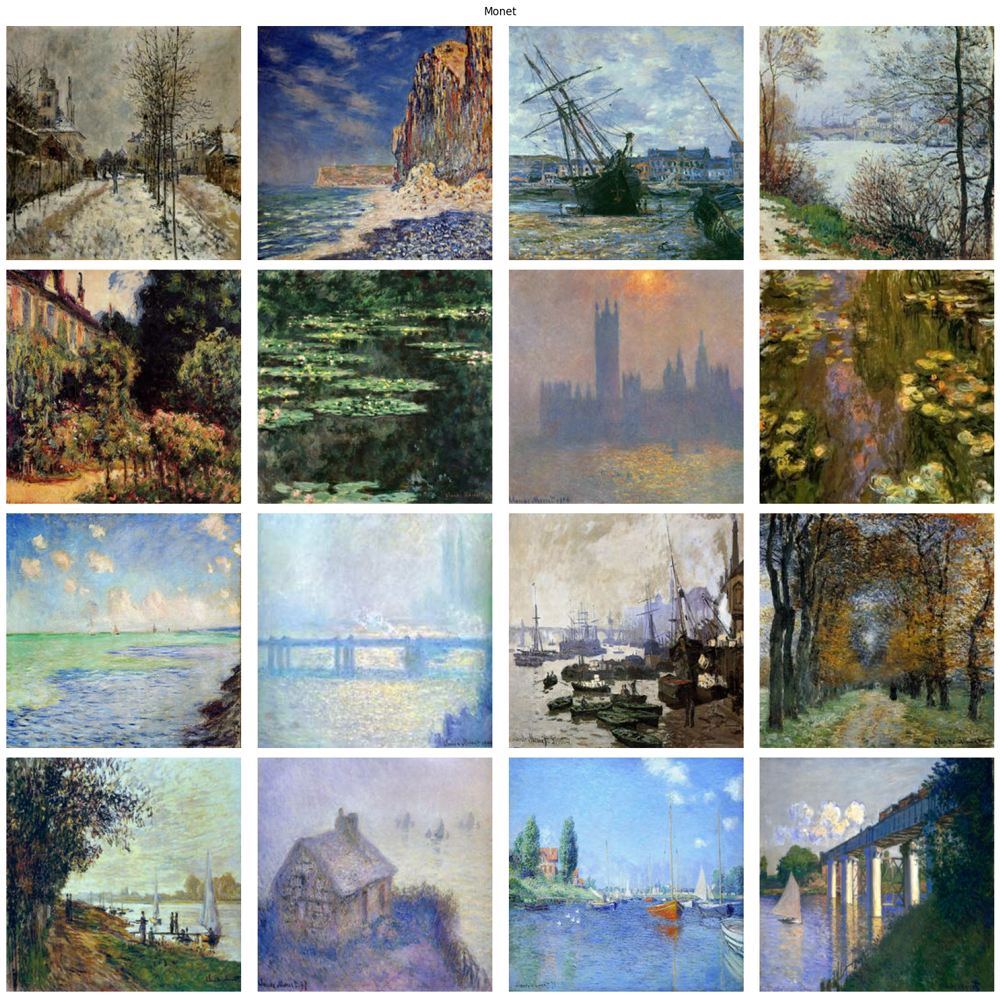

In [9]:
# show monet images
show_dataset(monet_ds, label='Monet')

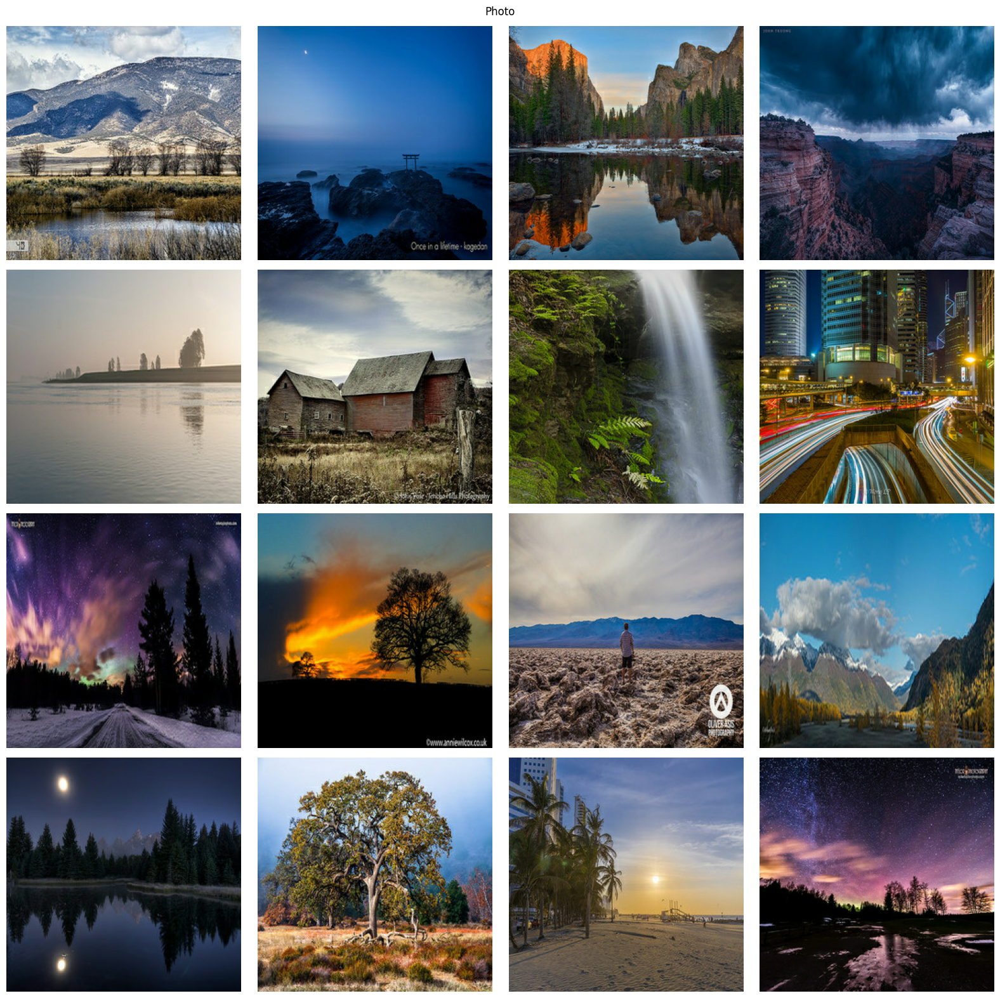

In [10]:
# show the photo images
show_dataset(photo_ds, label='Photo')

In this task, we will use CycleGAN to transform these real photos into Monet-style images.

# Model Architecture

We will use a U-Net architecture for the CycleGAN.

## U-Net Architecture
U-Net performs down-sampling to capture a larger receptive field using convolution layers and then uses up-sampling to restore the image resolution. However, during the up-sampling process, some spatial information may be lost. To mitigate this, skip connections are added between corresponding layers in the down-sampling and up-sampling stages to directly pass resolution information, helping the model maintain fine-grained details.

## Initializer Settings
In the [tutorial](https://www.kaggle.com/code/amyjang/monet-cyclegan-tutorial) that we referred to, the random_normal_initializer was used as the initializer for both the Generator and Discriminator.
However, in this experiment, we will use:
- Orthogonal Initializer for the Generator
- VarianceScaling Initializer for the Discriminator

### Orthogonal Initializer (for Generator)
The Orthogonal Initializer is designed to stabilize training by ensuring the eigenvalues of the weight matrix remain close to 1. This prevents gradient vanishing or exploding issues during backpropagation, even after multiple matrix multiplications. By maintaining stable gradients, we can expect a more stable and efficient training process.

Reference: [Orthogonal Initialization](https://smerity.com/articles/2016/orthogonal_init.html)

### VarianceScaling Initializer (for Discriminator)
The VarianceScaling Initializer scales the randomly sampled weight values based on the input size of the layer. This method helps to keep the variance of activations and gradients stable, reducing the risk of gradient vanishing or exploding during training.

By applying these initializers, we aim to enhance the stability and performance of the CycleGAN model.

## Down Sampling Layer
We will create the down-sampling layer for the U-Net architecture.
There are slight differences depending on whether Instance Normalization is applied, but the overall structure is as follows:

- Conv2D(stride=2) → (Instance Normalization) → LeakyReLU
We use the HeNormal initializer for the Conv2D layer to avoid vanishing gradients during training.


### Weight Initialization in HeNormal
In the HeNormal initializer, the weights are initialized as follows:
$$
W \sim \mathcal{N} \left( 0, \sqrt{\frac{2}{n_{\text{in}}}} \right)
$$
$$
n_{\text{in}}：\text{The number of input units for that layer}
$$
$$
\text{Standard deviation: } \sigma = \sqrt{\frac{2}{n_{\text{in}}}}
$$

By using HeNormal initialization, the model can achieve faster and more stable convergence by mitigating gradient vanishing issues.

In [11]:
# define downsampling layer function
def downsample(filters, size, apply_instancenorm=True):
    # initializer = tf.random_normal_initializer(0., 0.02)
    initializer = tf.keras.initializers.HeNormal()
    gamma_init = keras.initializers.RandomNormal(mean=0.0, stddev=0.02)

    model = keras.Sequential()
    model.add(layers.Conv2D(filters, size, strides=2, padding='same',
                             kernel_initializer=initializer, 
                             use_bias=False))

    if apply_instancenorm:
        model.add(layers.GroupNormalization(groups=-1, gamma_initializer=gamma_init)) # Instance Normalization

    model.add(layers.LeakyReLU())
    return model

## Up Sampling Layer
We will create the up-sampling layer for the U-Net architecture.
There are some differences depending on whether Dropout is applied, but the overall structure is as follows:

- Conv2DTranspose → Instance Normalization → (Dropout(0.5)) → ReLU
We use the HeNormal initializer for the Conv2DTranspose layer to prevent vanishing gradients during training. This initialization helps stabilize and accelerate the learning process.

In [12]:
# define upsampling layer function
def upsample(filters, size, apply_dropout=False):
    # initializer = tf.random_normal_initializer(0., 0.02)
    initializer = tf.keras.initializers.HeNormal()
    gamma_init = keras.initializers.RandomNormal(mean=0.0, stddev=0.02)

    model = keras.Sequential()
    model.add(layers.Conv2DTranspose(filters, size, strides=2,
                                      padding='same',
                                      kernel_initializer=initializer,
                                      use_bias=False))

    model.add(layers.GroupNormalization(groups=-1, gamma_initializer=gamma_init)) # Instance Normalization

    if apply_dropout:
        model.add(layers.Dropout(0.5))

    model.add(layers.LeakyReLU())
    return model

## Generator
The Generator is constructed using a U-Net structure, which combines the Down Sampling Layer and Up Sampling Layer.
The overall architecture is as follows:

- Input(256, 256, 3) -> downsample(64) instance normなし -> downsample(128) -> downsample(256) x 4
-> downsample(512): center
-> upsample(256) x4 -> upsample(128) -> upsample(64) 
-> Conv2DTranspose(stride=2)

In [13]:
# define Generator
def Generator():
    channels = 3
    inputs = layers.Input(shape=[256, 256, channels])

    # bs = batch size
    down_stack = [
        downsample(64, 4, apply_instancenorm=False), # (bs, 128, 128, 64)
        downsample(128, 4), # (bs, 64, 64, 128)
        downsample(256, 4), # (bs, 32, 32, 256)
        downsample(512, 4), # (bs, 16, 16, 512)
        downsample(512, 4), # (bs, 8, 8, 512)
        downsample(512, 4), # (bs, 4, 4, 512)
        downsample(512, 4), # (bs, 2, 2, 512)
    ]

    center_layer = downsample(512, 4) # (bs, 1, 1, 512)

    up_stack = [
        upsample(512, 4, apply_dropout=True), # (bs, 2, 2, 1024)
        upsample(512, 4, apply_dropout=True), # (bs, 4, 4, 1024)
        upsample(512, 4, apply_dropout=True), # (bs, 8, 8, 1024)
        upsample(512, 4), # (bs, 16, 16, 1024)
        upsample(256, 4), # (bs, 32, 32, 512)
        upsample(128, 4), # (bs, 64, 64, 256)
        upsample(64, 4),  # (bs, 128, 128, 128)
    ]

    # initializer = tf.random_normal_initializer(0., 0.02)
    initializer = tf.keras.initializers.Orthogonal(gain=0.02)
    last = layers.Conv2DTranspose(filters=channels, 
                                  kernel_size=4,
                                  strides=2,
                                  padding='same',
                                  kernel_initializer=initializer,
                                  activation='tanh') # (bs, 256, 256, 3)

    # Build Generator
    x = inputs

    # Downsampling through the model
    skips = []
    for down in down_stack:
        x = down(x)
        skips.append(x)

    # center layer
    x = center_layer(x)
    skips = reversed(skips)

    # Upsampling and establishing the skip connections
    for up, skip in zip(up_stack, skips):
        x = up(x)
        x = layers.Concatenate()([x, skip])

    # last layer
    x = last(x)

    return keras.Model(inputs=inputs, outputs=x)

## Discriminator
Discriminator can distinguish between images generated by the Generator and real images. The structure is slightly modified and defined as follows:

- Input(256, 256, 3) -> downsample(64) instance normなし -> downsample(128) -> downsample(256) -> ZeroPadding2D -> Conv2D(512) -> Instance Normalization -> Dropout(0.2) ->LeakyReLU-> ZeroPadding2D -> Conv2D

In [14]:
# define Discriminator
def Discriminator():
    # initializer = tf.random_normal_initializer(0., 0.02)
    initializer = tf.keras.initializers.VarianceScaling(scale=2.0)
    gamma_init = keras.initializers.RandomNormal(mean=0.0, stddev=0.02)

    input = layers.Input(shape=[256, 256, 3], name='input_image')

    # input layer
    x = input

    down1 = downsample(64, 4, apply_instancenorm=False)(x) # (bs, 128, 128, 64)
    down2 = downsample(128, 4)(down1) # (bs, 64, 64, 128)
    down3 = downsample(256, 4)(down2) # (bs, 32, 32, 256)

    zero_pad1 = layers.ZeroPadding2D()(down3) # (bs, 34, 34, 256)
    conv = layers.Conv2D(512, 4, strides=1,
                         kernel_initializer=initializer,
                         use_bias=False)(zero_pad1) # (bs, 31, 31, 512)

    norm1 = layers.GroupNormalization(groups=-1, gamma_initializer=gamma_init)(conv) # Instance Normalization
    dropout = layers.Dropout(0.2)(norm1)

    leaky_relu = layers.LeakyReLU()(dropout)

    zero_pad2 = layers.ZeroPadding2D()(leaky_relu) # (bs, 33, 33, 512)

    last = layers.Conv2D(1, 4, strides=1,
                         kernel_initializer=initializer)(zero_pad2) # (bs, 30, 30, 1)

    return tf.keras.Model(inputs=input, outputs=last)

In [15]:
# setup monet, photo generator and monet, photo discriminator
with strategy.scope():
    monet_generator = Generator() # transforms photos to Monet-esque paintings
    photo_generator = Generator() # transforms Monet paintings to be more like photos

    monet_discriminator = Discriminator() # differentiates real Monet paintings and generated Monet paintings
    photo_discriminator = Discriminator() # differentiates real photos and generated photos

I0000 00:00:1741567159.694971      10 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


Confirm that the Generator is initialized.
Since the Generator has not been trained yet, it outputs images in grayscale.

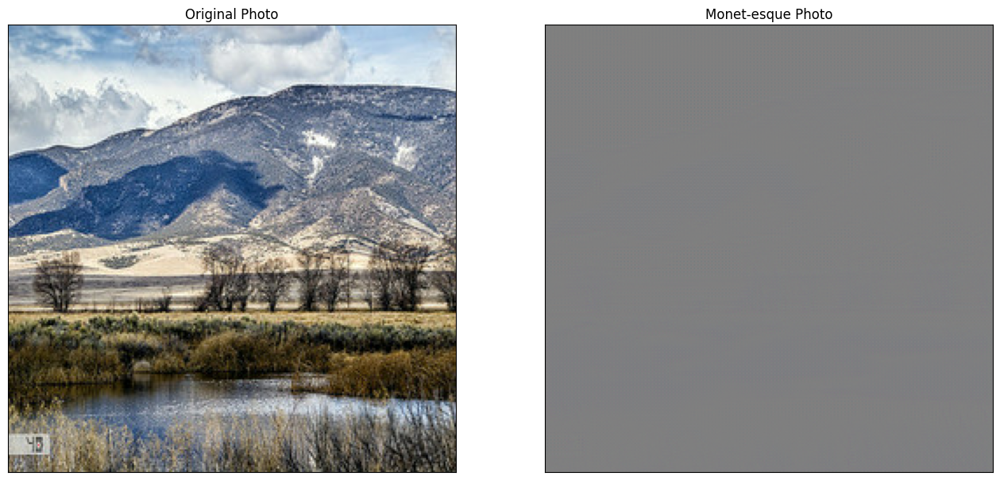

In [16]:
def show_initial_generator(dataset):
    photo = next(iter(dataset))
    to_monet = monet_generator(photo)
    plt.figure(figsize=(16, 16))
    plt.subplot(1, 2, 1)
    plt.title("Original Photo")
    plt.imshow(photo[0] * 0.5 + 0.5)
    plt.gca().get_xaxis().set_visible(False)
    plt.gca().get_yaxis().set_visible(False)
    
    plt.subplot(1, 2, 2)
    plt.title("Monet-esque Photo")
    plt.imshow(to_monet[0] * 0.5 + 0.5)
    plt.gca().get_xaxis().set_visible(False)
    plt.gca().get_yaxis().set_visible(False)
    plt.show()
show_initial_generator(photo_ds)

## CycleGAN model
I will construct the CycleGAN.

In CycleGAN, both the Generator and Discriminator are used to transform the original photo into a Monet-styled image, and then perform the reverse transformation. The difference between the transformed image and the original image is defined as the cycle-consistency loss. These losses are used to train the model.

In [17]:
# define CycleGAN class
class CycleGan():
    def __init__(
        self,
        monet_generator,
        photo_generator,
        monet_discriminator,
        photo_discriminator,
        lambda_cycle=10,
    ):
        self.m_gen = monet_generator
        self.p_gen = photo_generator
        self.m_disc = monet_discriminator
        self.p_disc = photo_discriminator
        self.lambda_cycle = lambda_cycle

    def compile(
        self,
        m_gen_optimizer,
        p_gen_optimizer,
        m_disc_optimizer,
        p_disc_optimizer,
        gen_loss_fn,
        disc_loss_fn,
        cycle_loss_fn,
        identity_loss_fn
    ):
        self.m_gen_optimizer = m_gen_optimizer
        self.p_gen_optimizer = p_gen_optimizer
        self.m_disc_optimizer = m_disc_optimizer
        self.p_disc_optimizer = p_disc_optimizer
        self.gen_loss_fn = gen_loss_fn
        self.disc_loss_fn = disc_loss_fn
        self.cycle_loss_fn = cycle_loss_fn
        self.identity_loss_fn = identity_loss_fn

    @tf.function
    def distributed_train_step(self, batch_data):
        losses = strategy.run(self.train_step, args=(batch_data,))
        return losses

    def train_step(self, batch_data):
        real_monet, real_photo = batch_data
        
        with tf.GradientTape(persistent=True) as tape:
            # photo to monet back to photo
            fake_monet = self.m_gen(real_photo, training=True)
            cycled_photo = self.p_gen(fake_monet, training=True)

            # monet to photo back to monet
            fake_photo = self.p_gen(real_monet, training=True)
            cycled_monet = self.m_gen(fake_photo, training=True)

            # generating itself
            same_monet = self.m_gen(real_monet, training=True)
            same_photo = self.p_gen(real_photo, training=True)

            # discriminator used to check, inputing real images
            disc_real_monet = self.m_disc(real_monet, training=True)
            disc_real_photo = self.p_disc(real_photo, training=True)

            # discriminator used to check, inputing fake images
            disc_fake_monet = self.m_disc(fake_monet, training=True)
            disc_fake_photo = self.p_disc(fake_photo, training=True)

            # evaluates generator loss
            monet_gen_loss = self.gen_loss_fn(disc_fake_monet)
            photo_gen_loss = self.gen_loss_fn(disc_fake_photo)

            # evaluates total cycle consistency loss
            total_cycle_loss = self.cycle_loss_fn(real_monet, cycled_monet, self.lambda_cycle) + self.cycle_loss_fn(real_photo, cycled_photo, self.lambda_cycle)

            # evaluates total generator loss
            total_monet_gen_loss = monet_gen_loss + total_cycle_loss + self.identity_loss_fn(real_monet, same_monet, self.lambda_cycle)
            total_photo_gen_loss = photo_gen_loss + total_cycle_loss + self.identity_loss_fn(real_photo, same_photo, self.lambda_cycle)

            # evaluates discriminator loss
            monet_disc_loss = self.disc_loss_fn(disc_real_monet, disc_fake_monet)
            photo_disc_loss = self.disc_loss_fn(disc_real_photo, disc_fake_photo)

        # Calculate the gradients for generator and discriminator
        monet_generator_gradients = tape.gradient(total_monet_gen_loss,
                                                  self.m_gen.trainable_variables)
        photo_generator_gradients = tape.gradient(total_photo_gen_loss,
                                                  self.p_gen.trainable_variables)

        monet_discriminator_gradients = tape.gradient(monet_disc_loss,
                                                      self.m_disc.trainable_variables)
        photo_discriminator_gradients = tape.gradient(photo_disc_loss,
                                                      self.p_disc.trainable_variables)

        # Apply the gradients to the optimizer
        self.m_gen_optimizer.apply_gradients(zip(monet_generator_gradients,
                                                 self.m_gen.trainable_variables))

        self.p_gen_optimizer.apply_gradients(zip(photo_generator_gradients,
                                                 self.p_gen.trainable_variables))

        self.m_disc_optimizer.apply_gradients(zip(monet_discriminator_gradients,
                                                  self.m_disc.trainable_variables))

        self.p_disc_optimizer.apply_gradients(zip(photo_discriminator_gradients,
                                                  self.p_disc.trainable_variables))
            
        return {
            "monet_gen_loss": total_monet_gen_loss,
            "photo_gen_loss": total_photo_gen_loss,
            "monet_disc_loss": monet_disc_loss,
            "photo_disc_loss": photo_disc_loss
        }

    def plot_generated_image(self, real_potho):
        to_monet = self.m_gen(real_potho)
        plt.figure(figsize=(16, 16))
        plt.subplot(1, 2, 1)
        plt.title("Original Photo")
        plt.imshow(real_potho[0] * 0.5 + 0.5)
        plt.gca().get_xaxis().set_visible(False)
        plt.gca().get_yaxis().set_visible(False)
        
        plt.subplot(1, 2, 2)
        plt.title("Monet-esque Photo")
        plt.imshow(to_monet[0] * 0.5 + 0.5)
        plt.gca().get_xaxis().set_visible(False)
        plt.gca().get_yaxis().set_visible(False)
        plt.show()

    def fit(self, batch_data, epochs, verbose=False):
        for epoch in range(epochs):
            dataset_length = sum(1 for _ in batch_data)
            for data in tqdm(batch_data, total=dataset_length):
                loss = self.distributed_train_step(data)
            # show the images
            if epoch % 10 == 0:
                _ , real_photo = list(batch_data.take(1))[0]
                if verbose:
                    self.plot_generated_image(real_photo)


## Loss functions
- Discriminator Loss: Measures whether the discriminator correctly identifies a fake image.
- Generator Loss: Measures whether the generator successfully makes the fake image appear as real to the discriminator.
- Cycle Loss: Measures how much the original image can be transformed and then returned to its original form after the reverse transformation.
- Identity Loss: Measures how similar the original image is to the transformed image when passed through the same generator without style transfer.

In [18]:
# define discriminator loss function
with strategy.scope():
    def discriminator_loss(real, generated):
        real_loss_binary_cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True, reduction=tf.keras.losses.Reduction.NONE)
        real_loss = real_loss_binary_cross_entropy(tf.ones_like(real), real)

        generated_loss_binary_cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True, reduction=tf.keras.losses.Reduction.NONE)
        generated_loss = generated_loss_binary_cross_entropy(tf.zeros_like(generated), generated)

        total_disc_loss = real_loss + generated_loss
        return total_disc_loss * 0.5

In [19]:
# define generator loss function
with strategy.scope():
    def generator_loss(generated):
        return tf.keras.losses.BinaryCrossentropy(from_logits=True, reduction=tf.keras.losses.Reduction.NONE)(tf.ones_like(generated), generated)

In [20]:
# define cycle loss function
with strategy.scope():
    def calc_cycle_loss(real_image, cycled_image, LAMBDA):
        loss1 = tf.reduce_mean(tf.abs(real_image - cycled_image))
        return LAMBDA * loss1

In [21]:
# define identity loss
with strategy.scope():
    def identity_loss(real_image, same_image, LAMBDA):
        loss1 = tf.reduce_mean(tf.abs(real_image - same_image))
        return LAMBDA * 0.5 * loss1

In [22]:
# instantiate optimizers
with strategy.scope():
    monet_generator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
    photo_generator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

    monet_discriminator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
    photo_discriminator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

In [23]:
with strategy.scope():
    cycle_gan_model = CycleGan(
        monet_generator, photo_generator, monet_discriminator, photo_discriminator
    )

    cycle_gan_model.compile(
        m_gen_optimizer = monet_generator_optimizer,
        p_gen_optimizer = photo_generator_optimizer,
        m_disc_optimizer = monet_discriminator_optimizer,
        p_disc_optimizer = photo_discriminator_optimizer,
        gen_loss_fn = generator_loss,
        disc_loss_fn = discriminator_loss,
        cycle_loss_fn = calc_cycle_loss,
        identity_loss_fn = identity_loss
    )

Run the CycleGAN.
This time, we will set the number of epochs to 150.

In [24]:
cycle_gan_model.fit(
        tf.data.Dataset.zip((monet_ds, photo_ds)),
        epochs=150
    )

  0%|          | 0/300 [00:00<?, ?it/s]I0000 00:00:1741567225.686998      10 encapsulate_tpu_computations_pass.cc:266] Subgraph fingerprint:7315875648397693579
E0000 00:00:1741567227.960103      10 meta_optimizer.cc:966] model_pruner failed: INVALID_ARGUMENT: Graph does not contain terminal node adam/Add/ReadVariableOp.
I0000 00:00:1741567230.726469     746 tpu_compilation_cache_interface.cc:442] TPU host compilation cache miss: cache_key(14642566929101598104), session_name()
I0000 00:00:1741567301.931288     746 tpu_compile_op_common.cc:245] Compilation of 14642566929101598104 with session name  took 1m11.204760374s and succeeded
I0000 00:00:1741567302.131646     746 tpu_compilation_cache_interface.cc:476] TPU host compilation cache: compilation complete for cache_key(14642566929101598104), session_name(), subgraph_key(std::string(property.function_name) = "cluster_distributed_train_step_7315875648397693579", property.function_library_fingerprint = 4600043470942826222, property.mlir_m

# Results and Analysis
After training, verify if the generated images have adopted Monet's style.

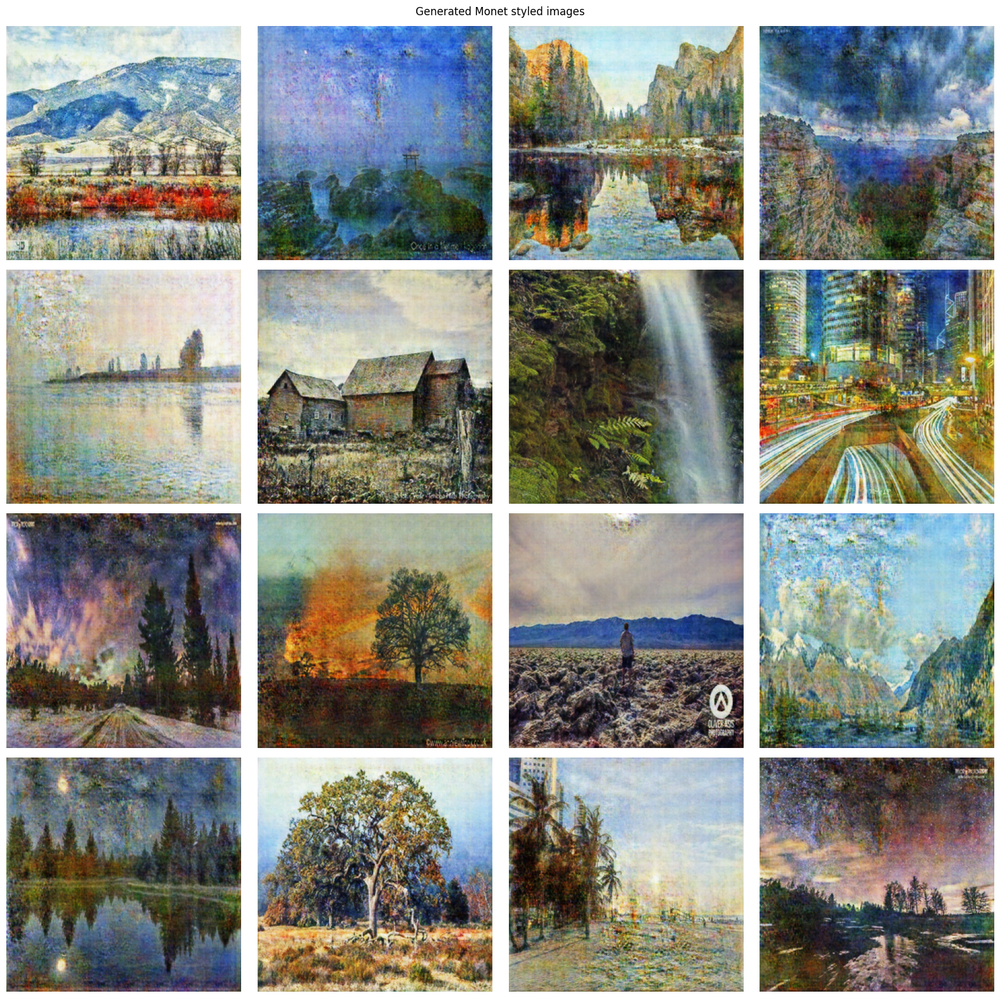

In [25]:
# show generated images
def show_generated_images(dataset, label=None):
    fig, axes = plt.subplots(4, 4, figsize=(16, 16))
    data_iterator = iter(dataset)
    for ax in axes.flatten():
        img = next(data_iterator)
        prediction = monet_generator(img, training=False)[0].numpy()
        prediction = (prediction * 127.5 + 127.5).astype(np.uint8)
        ax.imshow(prediction)
        ax.axis("off")
    plt.tight_layout(rect=[0, 0, 1, 0.97])
    fig.suptitle(label)
    plt.show()
show_generated_images(photo_ds, 'Generated Monet styled images')

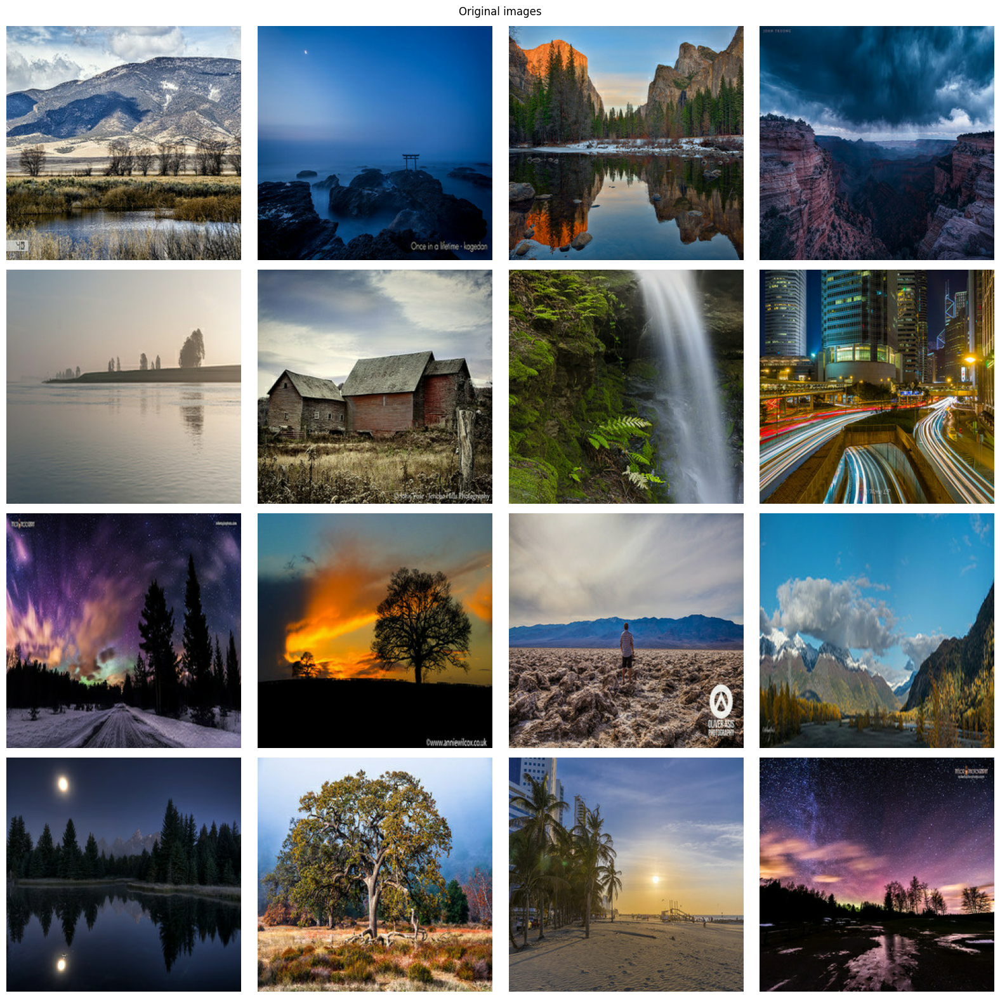

In [26]:
# show original images
show_dataset(photo_ds, 'Original images')

# Conclusion 

This time, images were generated using a CycleGAN model.
By utilizing the U-Net architecture, the image information is connected through skip connections, which allows the model to produce Monet-like images even with deep layers.

Since we didn't incorporate the Self-Attention mechanism this time, it could be an interesting challenge in the future to explore which parts of the image to focus on in order to generate more Monet-style images.

# Create submission file

In [27]:
import PIL
! mkdir ../images

In [ ]:
i = 1
for img in photo_ds:
    prediction = monet_generator(img, training=False)[0].numpy()
    prediction = (prediction * 127.5 + 127.5).astype(np.uint8)
    im = PIL.Image.fromarray(prediction)
    im.save("../images/" + str(i) + ".jpg")
    i += 1

In [ ]:
shutil.make_archive("/kaggle/working/images", 'zip', "/kaggle/images")

- https://www.kaggle.com/code/amyjang/monet-cyclegan-tutorial
- https://www.kaggle.com/code/wendykan/demo-mifid-metric-for-dog-image-generation-comp
- https://www.claude-monet.com
- https://jonathan-hui.medium.com/gan-cyclegan-6a50e7600d7